The content of this notebook, regarding eye tracking, was done by Marco Monteverde (S4813909) and Vasilii Tregubov (S6131225) for the Computer Vision course (final project) at Univeristy of Genoa.

# Eye Tracking

In [1]:
#!pip install opencv-python ipywidgets
#!pip install facenet_pytorch
#!pip install moviepy
#!pip install matplotlib pillow

In [3]:
# Standart
import numpy as np
import matplotlib.pyplot as plt
import random

# Pupil detection
import cv2
from google.colab.patches import cv2_imshow
from facenet_pytorch import MTCNN

# Calibration
from IPython.display import Image, Video, display, Javascript, HTML
from google.colab import output
from sklearn.linear_model import LinearRegression

# Video recording
import time
from google.colab.output import eval_js
from base64 import b64decode

# Eye tracking
import os
#!apt-get update
#!apt-get install ffmpeg

**1. Banny algorithm's functions for pupil detection**

In [ ]:
# Initialize MTCNN model
mtcnn = MTCNN(keep_all=True)

# Image preprocessing
def image_preproc(image, color, blurfilter):
  # Convert BGR to RGB or gray
  if color == 'rgb':
    preproc_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  elif color == 'gray':
    preproc_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  else:
    ValueError()

  # Gaussian blur
  preproc_image = cv2.GaussianBlur(preproc_image, blurfilter, 0)

  return preproc_image

  # Function for detecting eye-centers
def eyes_bounds(image):
  # Detect faces and landmarks
  boxes, probs, landmarks = mtcnn.detect(image, landmarks=True)

  # Drawing centers and potential cornea square
  if landmarks is not None:
        for landmark in landmarks:
            # Get the coordinates for the eyes
            left_eye = landmark[0]
            right_eye = landmark[1]

            # Predicting boundbox size
            r_ee = abs(left_eye[0] - right_eye[0])
            k_e_x = 30/63 #ratio between avg x lengh of eye and avg distance between eyes
            k_e_y = 25/63 #ratio between avg y lengh of eye and avg distance between eyes
            h_e_x = (r_ee * 1.25) * k_e_x / 2
            h_e_y = (r_ee * 1) * k_e_y / 2

            bounded_image = image.copy()

            # Centers
            cv2.drawMarker(bounded_image, (int(left_eye[0]), int(left_eye[1])), color = (255, 0, 0), markerType = cv2.MARKER_CROSS, markerSize = 5, thickness = 2)
            cv2.drawMarker(bounded_image, (int(right_eye[0]), int(right_eye[1])), color = (255, 0, 0), markerType = cv2.MARKER_CROSS, markerSize = 5, thickness = 2)

            # Draw bounding box around the eye center
            cv2.rectangle(bounded_image, (int(left_eye[0] - (h_e_x)), int(left_eye[1] - (h_e_y-5))), (int(left_eye[0] + (h_e_x)), int(left_eye[1] + (h_e_y+5))), (255, 0, 0), 2)
            cv2.rectangle(bounded_image, (int(right_eye[0] - (h_e_x)), int(right_eye[1] - (h_e_y-5))), (int(right_eye[0] + (h_e_x)), int(right_eye[1] + (h_e_y+5))), (255, 0, 0), 2)

  return bounded_image, left_eye, right_eye, h_e_x, h_e_y, r_ee

# Function for brut cropping ROI of the eyes
def eye_ROI(image, eye_cord, h_eye_x, h_eye_y):

    x_min = int(eye_cord[0] - (h_eye_x))
    x_max = int(eye_cord[0] + (h_eye_x))
    y_min = int(eye_cord[1] - (h_eye_y-5))
    y_max = int(eye_cord[1] + (h_eye_y+5))

    # Crop the image using array slicing
    cropped_image = image[y_min:y_max, x_min:x_max]

    return cropped_image

# Function for precise cropping ROI of the eyes
def eye_ROI_narrowed(image):
  edge = cv2.Canny(image, 50, 150)
  y_coords, x_coords = np.nonzero(edge)
  edge_points = np.column_stack((x_coords, y_coords))
  x_min = edge_points[:, 0].min()
  x_max = edge_points[:, 0].max()
  y_min = 0
  y_max = edge.shape[0]

  edged_image = edge.copy()
  cropped_image = edged_image[y_min:y_max, x_min:x_max]

  return cropped_image

def cornea_detection(image, r_ee, circle_senstvt):
  image_cornea = image.copy()
  image_pupil = image.copy()

  # ratio of the average horizontal length of the cornea to the distance between the eyes
  k_c = 12/63
  max_cornea_radius = int(r_ee * k_c / 2 + 1)

  center_x = int(image.shape[1] / 2)
  center_y = int(image.shape[0] / 2)

  # Hough Circle Transform
  corneas = cv2.HoughCircles(image, cv2.HOUGH_GRADIENT, dp=1, minDist=100,
                                param1=50, param2=circle_senstvt, minRadius = int(max_cornea_radius/3), maxRadius = max_cornea_radius)

  cornea = corneas[0]

  if cornea is not None:
      # Convert the (x, y) coordinates and radius of the circles to integers
      cornea = np.round(cornea[0, :]).astype("int")

      cv2.circle(image_cornea, (cornea[0], cornea[1]), cornea[2], (255, 0, 0), 4)
      cv2.drawMarker(image_cornea, (cornea[0], cornea[1]), color = (255, 0, 0), markerType = cv2.MARKER_CROSS, markerSize = 1, thickness = 2)

      cv2.drawMarker(image_pupil, (cornea[0], cornea[1]), color = (255, 0, 0), markerType = cv2.MARKER_CROSS, markerSize = 1, thickness = 2)
      cv2.drawMarker(image_pupil, (center_x, center_y), color = (0, 255, 0), markerType = cv2.MARKER_CROSS, markerSize = 1, thickness = 2)

  # View direction vector
  view_vector = [-(cornea[0] - center_x), -(cornea[1] - center_y)]

  return image_cornea, image_pupil, cornea, view_vector

def pupil_detection(image, blur, circle_senstvt):
  # 0. Image preprocessing
  image_prepr = image_preproc(image, 'rgb', blur)

  # 1. Eye squares detection
  image_eye_bounds, lc_cord, rc_cord, h_x, h_y, r = eyes_bounds(image_prepr)
    # Crop left square
  image_left_eye = eye_ROI(image, lc_cord, h_x, h_y)
  image_left_eye = image_preproc(image_left_eye, 'gray', blur)
  image_left_eye = eye_ROI_narrowed(image_left_eye)
    # Crop right square
  image_right_eye = eye_ROI(image, rc_cord, h_x, h_y)
  image_right_eye = image_preproc(image_right_eye, 'gray', blur)
  image_right_eye = eye_ROI_narrowed(image_right_eye)

  # 2. Cornea and pupil detection
  try:
    left_cornea_edge_img, left_pupil_img, left_cornea_cord, left_eye_vector = cornea_detection(image_left_eye, r, circle_senstvt)
    right_cornea_edge_img, right_pupil_img, right_cornea_cord, right_eye_vector = cornea_detection(image_right_eye, r, circle_senstvt)
    corneas = [left_cornea_edge_img, right_cornea_edge_img]
    view_vector = (left_eye_vector + right_eye_vector) / 2
  except:
    try:
      left_cornea_edge_img, left_pupil_img, left_cornea_cord, left_eye_vector = cornea_detection(image_left_eye, r, circle_senstvt)
      corneas = [left_cornea_edge_img]
      view_vector = left_eye_vector
    except:
      right_cornea_edge_img, right_pupil_img, right_cornea_cord, right_eye_vector = cornea_detection(image_right_eye, r, circle_senstvt)
      corneas = [right_cornea_edge_img]
      view_vector = right_eye_vector

  p_ee = r / 63 # proportional coefficient

  return corneas, view_vector, p_ee

**2. Calibration functions**

In [ ]:
# 1. Define the calibration points on the screen.

# JavaScript to get screen dimensions and pass them to Python
js_code = """
<script>
  // Get screen dimensions
  var screenWidth = window.screen.width;
  var screenHeight = window.screen.height;

  // Send the screen dimensions to Python
  google.colab.kernel.invokeFunction('notebook.get_screen_size', [screenWidth, screenHeight], {});
</script>
"""

# Define a function to handle the screen size data
def get_screen_size(width, height):
    global screen_width, screen_height
    screen_width = width
    screen_height = height

# 2. Display each calibration point on the screen

def display_calibration_point(point, duration=2):
    image = np.zeros((screen_height, screen_width, 3), dtype=np.uint8)
    cv2.circle(image, (int(point[0]), int(point[1])), 10, (0, 0, 255), -1)
    cv2_imshow(image)
    cv2.waitKey(duration * 1000)

def calibration(calibration_examples):
  # 3. Collect the eye tracking data while the user looks at each point.

  # Collect calibration data
  eye_tracking_data = []

  for i in range(len(calibration_points)):
      _, view_vector, _ = pupil_detection(calibration_examples[i], (3,3), circle_senstvt=10)
      eye_tracking_data.append((view_vector, calibration_points[i]))

  # 4. Use the collected calibration data to train a mapping model.

  # Prepare data for model training
  eye_vectors = np.array([data[0] for data in eye_tracking_data])
  screen_points = np.array([data[1] for data in eye_tracking_data])

  # Train linear regression models for x and y coordinates
  model_x = LinearRegression()
  model_y = LinearRegression()

  model_x.fit(eye_vectors, screen_points[:, 0])
  model_y.fit(eye_vectors, screen_points[:, 1])

  print(f"Calibration completed")

  return model_x, model_y

  # 5. Use the trained model to predict screen coordinates from new eye tracking data.

def predict_screen_point(eye_vector, model_x, model_y):
      screen_x = model_x.predict([eye_vector])[0]
      screen_y = model_y.predict([eye_vector])[0]
      return (screen_x, screen_y)

**3. Eye tracking functions**

In [ ]:
# function for video recording
def record_video(filename='video.webm'):
    # Display the HTML and JavaScript
    display(Javascript('''
    async function recordVideo() {
        const video = document.createElement('video');
        const stream = await navigator.mediaDevices.getUserMedia({ video: true });
        video.srcObject = stream;
        await new Promise((resolve) => video.onloadedmetadata = resolve);
        const mediaRecorder = new MediaRecorder(stream);
        const chunks = [];
        mediaRecorder.ondataavailable = (e) => chunks.push(e.data);
        mediaRecorder.start();
        const stopped = new Promise((resolve, reject) => {
            mediaRecorder.onstop = resolve;
            mediaRecorder.onerror = (event) => reject(event.name);
        });
        const stop = () => mediaRecorder.state === 'recording' && mediaRecorder.stop();
        const recorded = await Promise.all([
            stopped,
            video.play().then(() => new Promise((resolve) => setTimeout(resolve, 15000))).then(stop),
        ]).then(() => chunks);
        const recordedBlob = new Blob(recorded, { type: 'video/webm' });
        const reader = new FileReader();
        reader.readAsDataURL(recordedBlob);
        return new Promise((resolve) => {
            reader.onloadend = () => resolve(reader.result);
        });
    }
    recordVideo();
    '''))
    # Capture the video data
    video_data = eval_js("recordVideo()")
    video_data = video_data.split(",")[1]
    with open(filename, "wb") as video_file:
        video_file.write(b64decode(video_data))

    print('Video is recorded')

In [ ]:
# function for delete all frames at the folder
def folder_cleaner(folder_path):
  # Check if the directory exists
  if os.path.exists(folder_path):
      # List all files in the directory
      files = os.listdir(folder_path)

      # Loop through and remove each file
      for file_name in files:
          file_path = os.path.join(folder_path, file_name)
          try:
              if os.path.isfile(file_path) or os.path.islink(file_path):
                  os.unlink(file_path)  # Remove the file or link
          except Exception as e:
              print(f'Failed to delete {file_path}. Reason: {e}')

      print(f'Directory is empty: {folder_path}')
  else:
      print(f'The directory does not exist: {folder_path}')

In [ ]:
# Helper function to generate the filename based on index
def generate_filename(index):
    return f"video_frames/frame_{index:03}.jpg"

def delete_file(file_path):
    if os.path.exists(file_path):
        os.remove(file_path)
        print(f"Deleted {file_path}")
    else:
        print(f"File {file_path} does not exist")

In [ ]:
# Create a directory for video frames
!mkdir video_frames
video_folder_path = 'video_frames'
if not os.path.exists(video_folder_path):
    os.makedirs(video_folder_path)

# Create a directory for tracking frames
!mkdir tracked_frames
track_folder_path = 'tracked_frames'
if not os.path.exists(track_folder_path):
    os.makedirs(track_folder_path)

# Experimental part

**1. Performing calibration**

In [6]:
# Register the function with Colab
output.register_callback('notebook.get_screen_size', get_screen_size)

# Display the JavaScript code to execute
display(HTML(js_code))

# Output the screen dimensions
try:
    display(f'Screen width: {screen_width}, Screen height: {screen_height}')
except NameError:
    display('Please run the cell again to get the screen size.')

# Define calibration points (e.g., 9-point calibration grid)
calibration_points = [
    (screen_width * 0.1, screen_height * 0.1),
    (screen_width * 0.5, screen_height * 0.1),
    (screen_width * 0.9, screen_height * 0.1),
    (screen_width * 0.1, screen_height * 0.5),
    (screen_width * 0.5, screen_height * 0.5),
    (screen_width * 0.9, screen_height * 0.5),
    (screen_width * 0.1, screen_height * 0.9),
    (screen_width * 0.5, screen_height * 0.9),
    (screen_width * 0.9, screen_height * 0.9)
]

# Creation of pictures for calibration
for point in calibration_points:
     display_calibration_point(point)
     time.sleep(1)

cv2.destroyAllWindows()

In [ ]:
#  Upload calibration examples (they are provided in the folder of this project)
UL = cv2.imread('UL4.jpg')
U = cv2.imread('U4.jpg')
UR = cv2.imread('UR4.jpg')
L = cv2.imread('L4.jpg')
F = cv2.imread('F4.jpg')
R = cv2.imread('R4.jpg')
DL = cv2.imread('DL4.jpg')
D = cv2.imread('D4.jpg')
DR = cv2.imread('DR4.jpg')

calibration_examples = [
    UL, U, UR,
    L,  F, R,
    DL, D, DR
]

# Do calibration
model_x, model_y = calibration(calibration_examples)

Calibration completed


**2. Video recording**

In [ ]:
# Delete all previous content

#Video
folder_cleaner(video_folder_path)
delete_file("video.webm")
delete_file("video.gif")

# Tracking
folder_cleaner(track_folder_path)
delete_file("tracking.webm")
delete_file("tracking.gif")

Directory is empty: video_frames
File video.webm does not exist
File video.gif does not exist
Directory is empty: tracked_frames
File tracking.webm does not exist
File tracking.gif does not exist


In [ ]:
# Record a video
record_video()

<IPython.core.display.Javascript object>

Video is recorded


In [ ]:
# Extract frames from the video
!ffmpeg -i video.webm -vf fps=30 video_frames/frame_%03d.jpg

files = os.listdir(video_folder_path)
num_files = len(files)

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Performing the eye tracking
circle_senstvt = 10

video_tracking_data = []

# Pupil detection loop
for i in range(0, num_files - 1):
    filename = generate_filename(i)
    img = cv2.imread(filename)
    try:
      _, view_vector, _ = pupil_detection(img, (3, 3), circle_senstvt)
      video_tracking_data.append([i, view_vector, predict_screen_point(view_vector, model_x, model_y)])
    except:
      video_tracking_data.append([i, [-100,-100], predict_screen_point([-100,-100], model_x, model_y)])

# Creation of the screen view point
for i in range(0, num_files - 1):
    tracking_path = os.path.join(track_folder_path, f"trame_{i:03}.jpg")
    blue_dot_image = np.zeros((screen_height, screen_width, 3), dtype=np.uint8)
    cv2.circle(blue_dot_image, (int(video_tracking_data[i][2][0]), int(video_tracking_data[i][2][1])), 10, (0, 255, 0), -1)
    cv2.imwrite(tracking_path, blue_dot_image)

tracked_files = os.listdir(track_folder_path)
num_tracked_files = len(tracked_files)

# Final proccessing

# Reassemble frames into a tracking video
!ffmpeg -framerate 30 -i tracked_frames/trame_%03d.jpg -c:v libvpx-vp9 tracking.webm

# Gif video
!ffmpeg -i video.webm -vf "scale=320:-1:flags=lanczos,split[s0][s1];[s0]palettegen[p];[s1][p]paletteuse" video.gif
!ffmpeg -i tracking.webm -vf "scale=320:-1:flags=lanczos,split[s0][s1];[s0]palettegen[p];[s1][p]paletteuse" tracking.gif

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

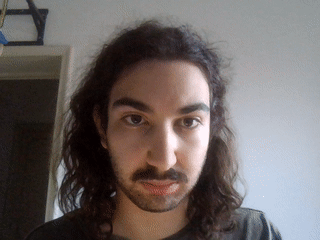

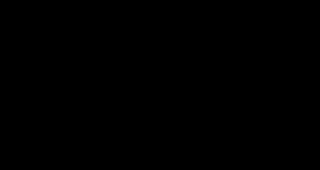

In [ ]:
# Showing_results
display(Image(filename='video.gif'))
display(Image(filename='tracking.gif'))